In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/kaggle/input/38cloud-cloud-segmentation-in-satellite-images/bibtex.txt
/kaggle/input/38cloud-cloud-segmentation-in-satellite-images/training_patches_38-cloud_nonempty.csv
/kaggle/input/38cloud-cloud-segmentation-in-satellite-images/38-Cloud_training/training_patches_38-Cloud.csv
/kaggle/input/38cloud-cloud-segmentation-in-satellite-images/38-Cloud_training/training_sceneids_38-Cloud.csv
/kaggle/input/38cloud-cloud-segmentation-in-satellite-images/38-Cloud_training/train_nir/nir_patch_316_16_by_1_LC08_L1TP_032029_20160420_20170223_01_T1.TIF
/kaggle/input/38cloud-cloud-segmentation-in-satellite-images/38-Cloud_training/train_nir/nir_patch_223_12_by_3_LC08_L1TP_002053_20160520_20170324_01_T1.TIF
/kaggle/input/38cloud-cloud-segmentation-in-satellite-images/38-Cloud_training/train_nir/nir_patch_181_9_by_13_LC08_L1TP_047023_20160920_20170221_01_T1.TIF
/kaggle/input/38cloud-cloud-segmentation-in-satellite-images/38-Cloud_training/train_nir/nir_patch_328_17_by_8_LC08_L1TP_002054_20160520_2017

In [34]:
import numpy as np
import matplotlib.pyplot as plt
from tifffile import imread
from pathlib import Path
from sklearn.model_selection import train_test_split
from skimage.io import imread


In [3]:
DATA_DIR = "/kaggle/input/38cloud-cloud-segmentation-in-satellite-images/38-Cloud_training"
red_dir   = Path(DATA_DIR) / "train_red"

In [4]:
all_red_files = sorted([f for f in red_dir.iterdir() if f.is_file()])
print("Total patches:", len(all_red_files))

Total patches: 8400


In [35]:
train_files, val_files = train_test_split(all_red_files, test_size=0.2, random_state=42)
print("Train patches:", len(train_files))
print("Validation patches:", len(val_files))




def cloud_patch_generator(file_list, batch_size=1, shuffle=True):
    file_list = list(file_list)               
    n_files = int(len(file_list))             
    batch_size = int(batch_size)              `
    indices = np.arange(n_files)
    
    while True:
        if shuffle:
            np.random.shuffle(indices)
        
        for start in range(0, n_files, batch_size):
            batch_indices = indices[start:start+batch_size]
            X_batch = []
            Y_batch = []
            
            for idx in batch_indices:
                r_file = file_list[idx]
                
                # Paths for other bands and mask
                g_file = str(r_file).replace("train_red", "train_green").replace("red", "green")
                b_file = str(r_file).replace("train_red", "train_blue").replace("red", "blue")
                nir_file = str(r_file).replace("train_red", "train_nir").replace("red", "nir")
                mask_file = str(r_file).replace("train_red", "train_gt").replace("red", "gt")
                
                # Load bands
                r = imread(r_file).astype(np.float32)
                g = imread(g_file).astype(np.float32)
                b = imread(b_file).astype(np.float32)
                nir = imread(nir_file).astype(np.float32)
                
                # Stack into 4-channel image and normalize (16-bit images)
                img = np.stack([r, g, b, nir], axis=-1) / 65535.0
                
                # Load mask and binarize
                mask = imread(mask_file)
                mask = (mask == 255).astype(np.float32)
                
                X_batch.append(img)
                Y_batch.append(mask)
            
            yield np.array(X_batch, dtype=np.float32), np.array(Y_batch, dtype=np.float32)

       

Train patches: 6720
Validation patches: 1680


In [36]:
train_gen = cloud_patch_generator(train_files, batch_size=16)
val_gen = cloud_patch_generator(val_files, batch_size=16, shuffle=False)

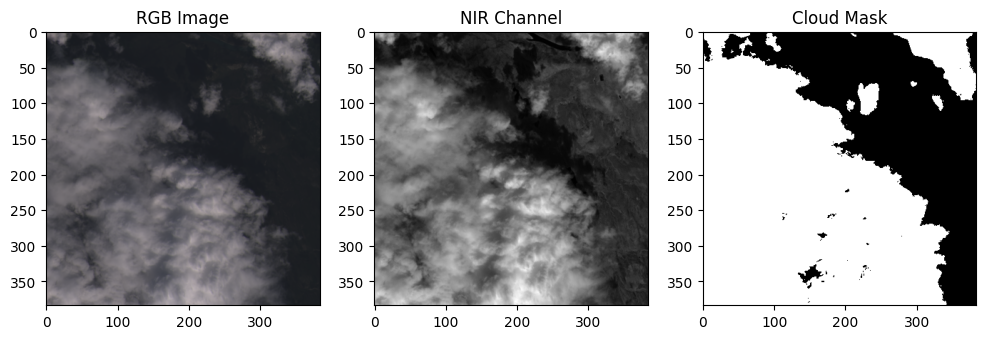

In [41]:
X, Y = next(train_gen)  # get one batch
img = X[4]              # first image in batch
mask = Y[4]             # corresponding mask

plt.figure(figsize=(12,5))

# RGB image
plt.subplot(1,3,1)
plt.imshow(img[..., :3])
plt.title("RGB Image")

# NIR channel
plt.subplot(1,3,2)
plt.imshow(img[..., 3], cmap='gray')
plt.title("NIR Channel")

# Mask
plt.subplot(1,3,3)
plt.imshow(mask, cmap='gray')
plt.title("Cloud Mask")

plt.show()

In [28]:
import tensorflow as tf
from tensorflow.keras import layers, models
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping, ReduceLROnPlateau
from tensorflow.keras.optimizers import Adam

In [24]:
def unet_model(input_size=(384,384,4)):
    inputs = tf.keras.Input(input_size)

    # Encoder
    c1 = layers.Conv2D(16, 3, activation='relu', padding='same')(inputs)
    c1 = layers.Conv2D(16, 3, activation='relu', padding='same')(c1)
    p1 = layers.MaxPooling2D(2)(c1)

    c2 = layers.Conv2D(32, 3, activation='relu', padding='same')(p1)
    c2 = layers.Conv2D(32, 3, activation='relu', padding='same')(c2)
    p2 = layers.MaxPooling2D(2)(c2)

    c3 = layers.Conv2D(64, 3, activation='relu', padding='same')(p2)
    c3 = layers.Conv2D(64, 3, activation='relu', padding='same')(c3)
    p3 = layers.MaxPooling2D(2)(c3)

    # Bottleneck
    c4 = layers.Conv2D(128, 3, activation='relu', padding='same')(p3)
    c4 = layers.Conv2D(128, 3, activation='relu', padding='same')(c4)

    # Decoder
    u5 = layers.UpSampling2D(2)(c4)
    u5 = layers.Concatenate()([u5, c3])
    c5 = layers.Conv2D(64, 3, activation='relu', padding='same')(u5)
    c5 = layers.Conv2D(64, 3, activation='relu', padding='same')(c5)

    u6 = layers.UpSampling2D(2)(c5)
    u6 = layers.Concatenate()([u6, c2])
    c6 = layers.Conv2D(32, 3, activation='relu', padding='same')(u6)
    c6 = layers.Conv2D(32, 3, activation='relu', padding='same')(c6)

    u7 = layers.UpSampling2D(2)(c6)
    u7 = layers.Concatenate()([u7, c1])
    c7 = layers.Conv2D(16, 3, activation='relu', padding='same')(u7)
    c7 = layers.Conv2D(16, 3, activation='relu', padding='same')(c7)

    outputs = layers.Conv2D(1, 1, activation='sigmoid')(c7)

    model = models.Model(inputs, outputs)
    return model

In [42]:



# Define Dice metric and losses

def dice_coefficient(y_true, y_pred, smooth=1e-6):
    y_true = tf.cast(y_true, tf.float32) 
    y_pred = tf.cast(y_pred, tf.float32)
    
    y_true_f = tf.keras.backend.flatten(y_true)
    y_pred_f = tf.keras.backend.flatten(y_pred)
    intersection = tf.keras.backend.sum(y_true_f * y_pred_f)
    return (2. * intersection + smooth) / (tf.keras.backend.sum(y_true_f) + tf.keras.backend.sum(y_pred_f) + smooth)

def dice_loss(y_true, y_pred):
    return 1 - dice_coefficient(y_true, y_pred)

def combined_loss(y_true, y_pred):
    return 0.5 * tf.keras.losses.binary_crossentropy(y_true, y_pred) + 0.5 * dice_loss(y_true, y_pred)


model = unet_model()  # your UNet function
model.summary()


model.compile(
    optimizer=Adam(learning_rate=1e-4), 
    loss=combined_loss, 
    metrics=['accuracy', dice_coefficient]
)


callbacks = [
    ModelCheckpoint('best_cloud_unet.h5', 
                    monitor='val_dice_coefficient',  
                    mode='max',  
                    save_best_only=True, 
                    verbose=1),
    EarlyStopping(patience=15, 
                  monitor='val_dice_coefficient',  
                  mode='max',  
                  restore_best_weights=True),
    ReduceLROnPlateau(factor=0.5, 
                      patience=7, 
                      monitor='val_dice_coefficient',  
                      mode='max',  
                      min_lr=1e-7,
                      verbose=1)
]


batch_size = 16
steps_per_epoch = len(train_files) // batch_size
validation_steps = len(val_files) // batch_size


history = model.fit(
    train_gen,
    steps_per_epoch=steps_per_epoch,
    validation_data=val_gen,
    validation_steps=validation_steps,
    epochs=15,
    callbacks=callbacks
)


Model: "functional_4"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_4       │ (None, 384, 384,  │          0 │ -                 │
│ (InputLayer)        │ 4)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_60 (Conv2D)  │ (None, 384, 384,  │        592 │ input_layer_4[0]… │
│                     │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_61 (Conv2D)  │ (None, 384, 384,  │      2,320 │ conv2d_60[0][0]   │
│                     │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d_12    │ (None, 192, 192,  │          0 │ conv2d_61[0][0]   │
│ (MaxPooling2D)      │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_62 (Conv2D)  │ (None, 192, 192,  │      4,640 │ max_pooling2d_12… │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_63 (Conv2D)  │ (None, 192, 192,  │      9,248 │ conv2d_62[0][0]   │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d_13    │ (None, 96, 96,    │          0 │ conv2d_63[0][0]   │
│ (MaxPooling2D)      │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_64 (Conv2D)  │ (None, 96, 96,    │     18,496 │ max_pooling2d_13… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_65 (Conv2D)  │ (None, 96, 96,    │     36,928 │ conv2d_64[0][0]   │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d_14    │ (None, 48, 48,    │          0 │ conv2d_65[0][0]   │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_66 (Conv2D)  │ (None, 48, 48,    │     73,856 │ max_pooling2d_14… │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_67 (Conv2D)  │ (None, 48, 48,    │    147,584 │ conv2d_66[0][0]   │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ up_sampling2d_12    │ (None, 96, 96,    │          0 │ conv2d_67[0][0]   │
│ (UpSampling2D)      │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ concatenate_12      │ (None, 96, 96,    │          0 │ up_sampling2d_12… │
│ (Concatenate)       │ 192)              │            │ conv2d_65[0][0]   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_68 (Conv2D)  │ (None, 96, 96,    │    110,656 │ concatenate_12[0… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_69 (Conv2D)  │ (None, 96, 96,    │     36,928 │ conv2d_68[0][0]   │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ up_sampling2d_13    │ (None, 192, 192,  │          0 │ conv2d_69[0][0] 

 Total params: 487,441 (1.86 MB)

 Trainable params: 487,441 (1.86 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/15
420/420 ━━━━━━━━━━━━━━━━━━━━ 0s 769ms/step - accuracy: 0.7668 - dice_coefficient: 0.5561 - loss: 0.4712
Epoch 1: val_dice_coefficient improved from -inf to 0.82866, saving model to best_cloud_unet.h5
420/420 ━━━━━━━━━━━━━━━━━━━━ 420s 979ms/step - accuracy: 0.7669 - dice_coefficient: 0.5564 - loss: 0.4709 - val_accuracy: 0.9241 - val_dice_coefficient: 0.8287 - val_loss: 0.1777 - learning_rate: 1.0000e-04
Epoch 2/15
420/420 ━━━━━━━━━━━━━━━━━━━━ 0s 715ms/step - accuracy: 0.9307 - dice_coefficient: 0.8437 - loss: 0.1671
Epoch 2: val_dice_coefficient improved from 0.82866 to 0.85459, saving model to best_cloud_unet.h5
420/420 ━━━━━━━━━━━━━━━━━━━━ 371s 884ms/step - accuracy: 0.9307 - dice_coefficient: 0.8437 - loss: 0.1671 - val_accuracy: 0.9395 - val_dice_coefficient: 0.8546 - val_loss: 0.1463 - learning_rate: 1.0000e-04
Epoch 3/15
420/420 ━━━━━━━━━━━━━━━━━━━━ 0s 695ms/step - accuracy: 0.9387 - dice_coefficient: 0.8612 - loss: 0.1498
Epoch 3: val_dice_coefficient improved from 0.

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


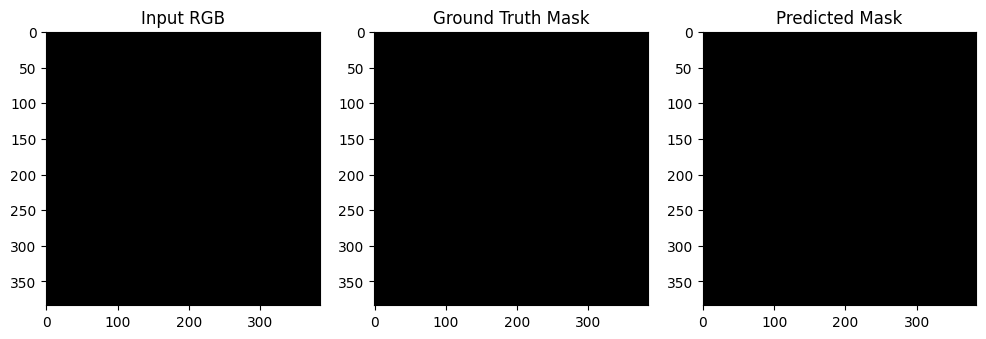

In [68]:
X_batch, Y_batch = next(val_gen)
pred_mask = model.predict(X_batch)
pred_mask = (pred_mask > 0.5).astype(np.float32)  # Binarize

plt.figure(figsize=(12,6))
plt.subplot(1,3,1)
plt.imshow(X_batch[0][..., :3])  # RGB
plt.title("Input RGB")
plt.subplot(1,3,2)
plt.imshow(Y_batch[0], cmap='gray')
plt.title("Ground Truth Mask")
plt.subplot(1,3,3)
plt.imshow(pred_mask[0,...,0], cmap='gray')
plt.title("Predicted Mask")
plt.show()

Total test patches: 9201
Test batch shape: (50, 384, 384, 4)
2/2 ━━━━━━━━━━━━━━━━━━━━ 8s 8s/step  
Predicted masks shape: (50, 384, 384, 1)


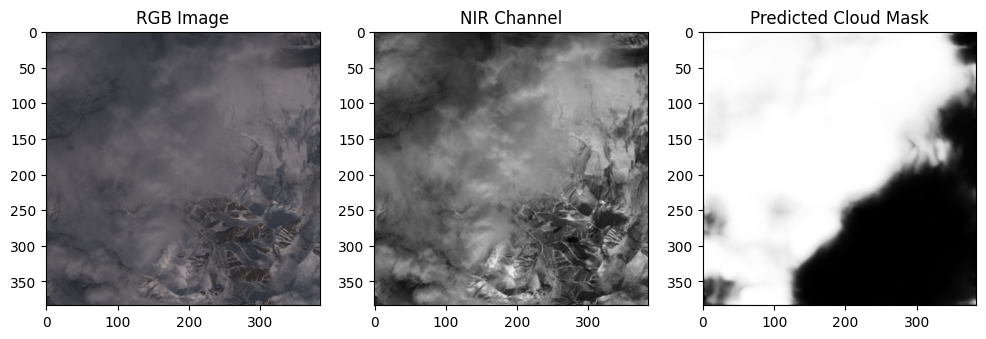

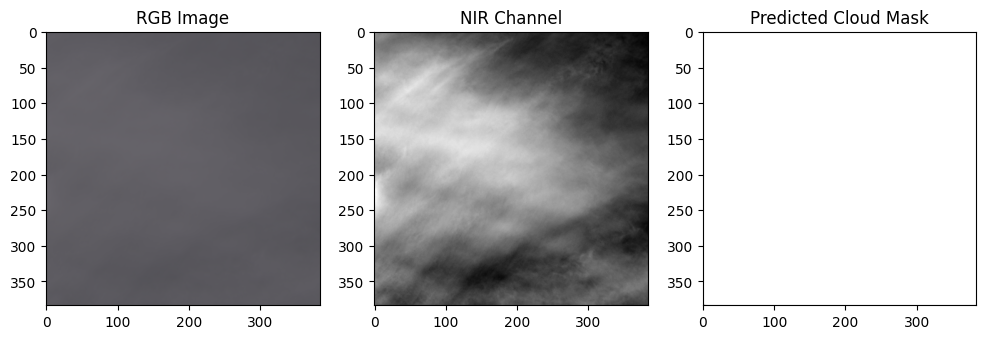

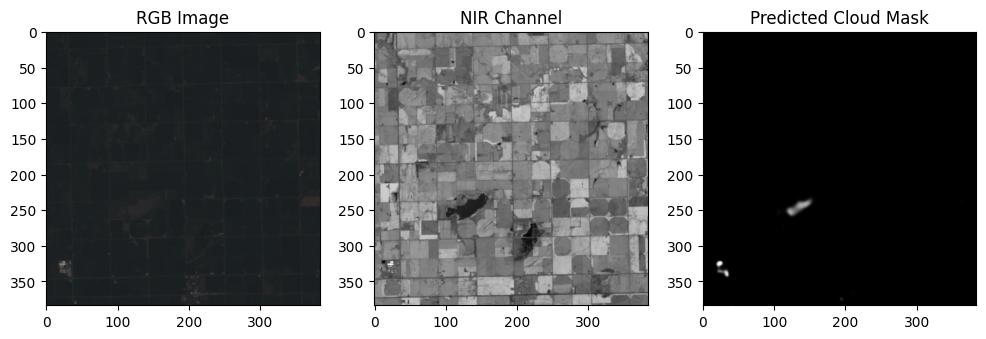

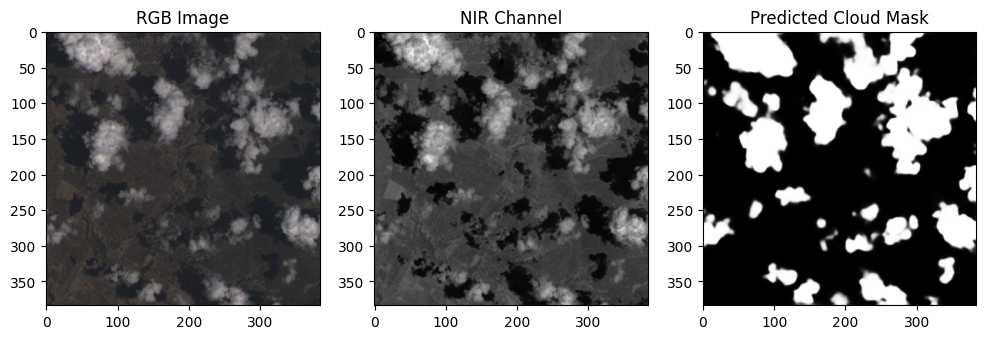

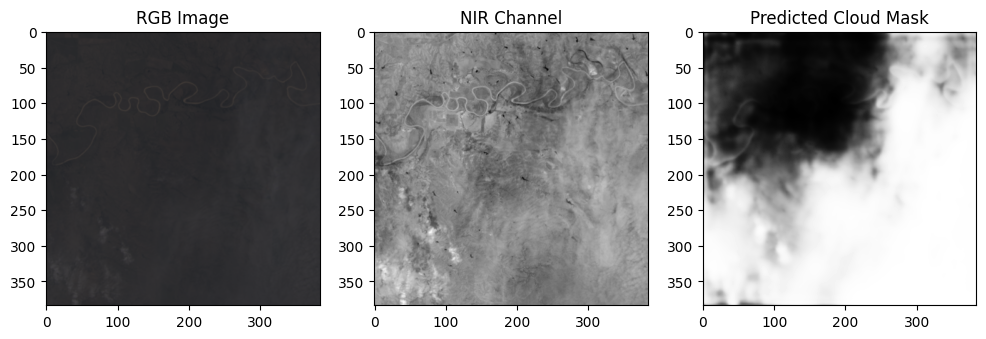

...

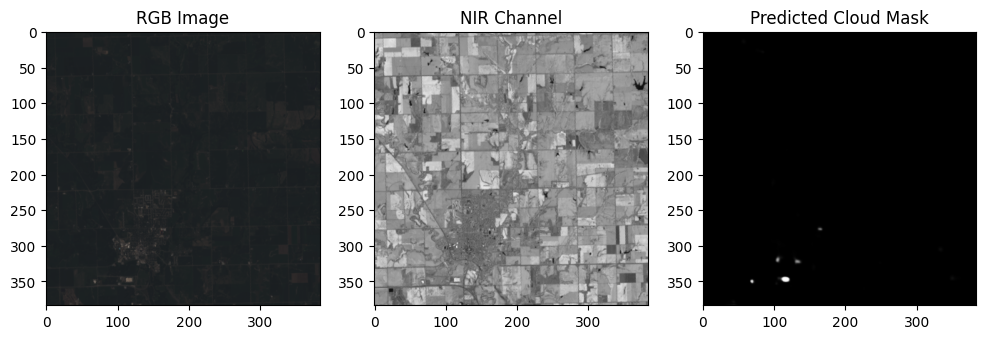

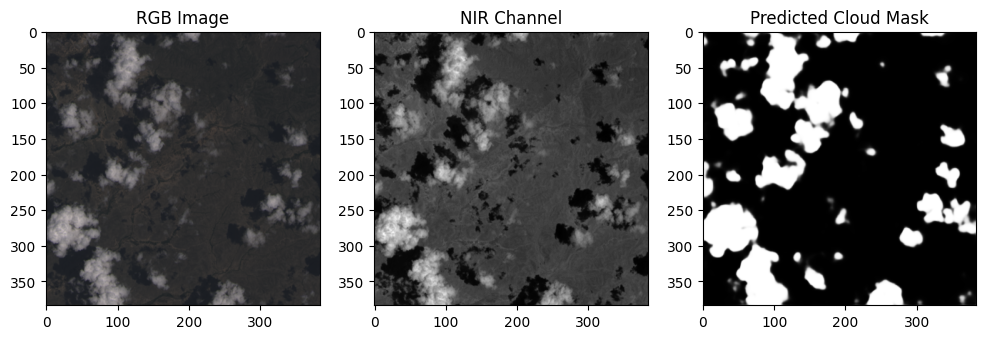

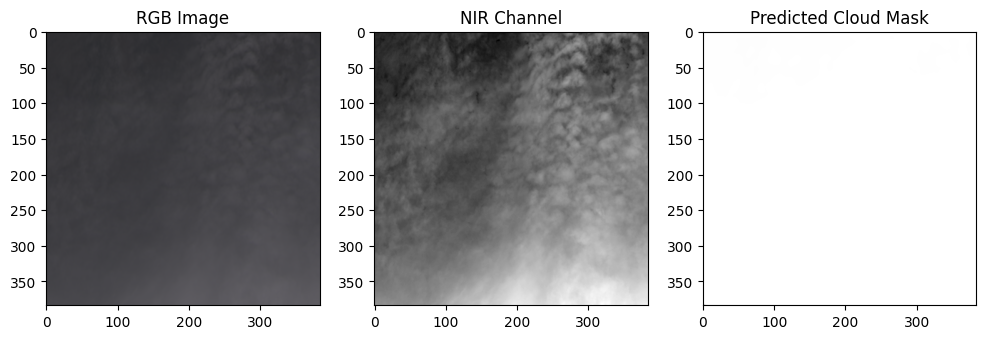

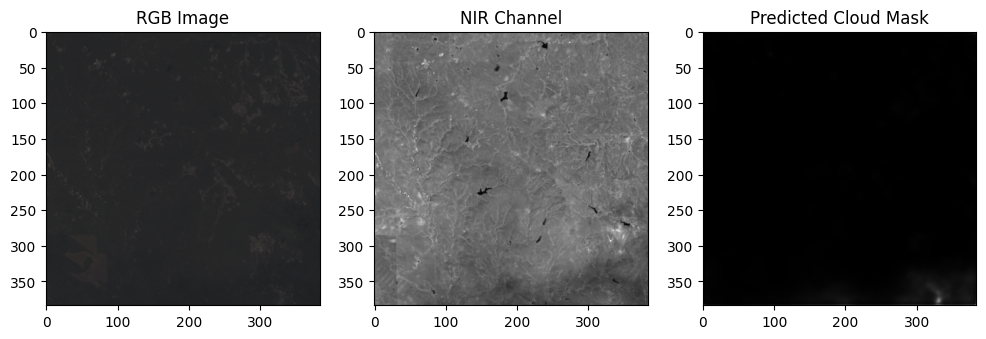

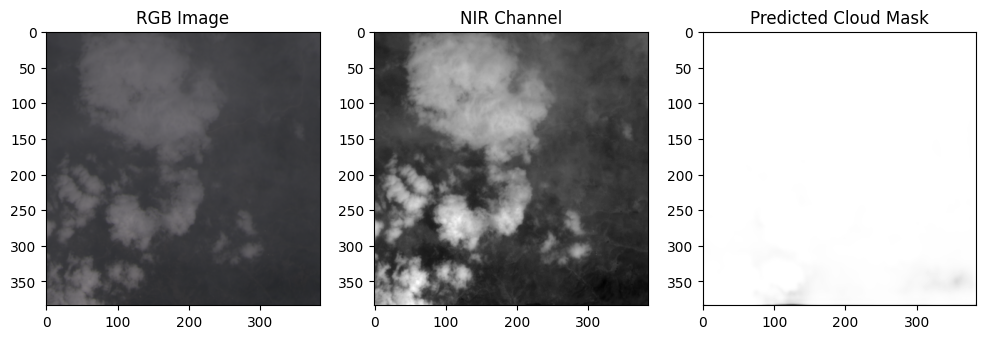

In [73]:
from skimage.io import imread
import os


test_red_dir = "/kaggle/input/38cloud-cloud-segmentation-in-satellite-images/38-Cloud_test/test_red"
test_files = sorted([os.path.join(test_red_dir, f) for f in os.listdir(test_red_dir) if f.endswith('.TIF')])
print("Total test patches:", len(test_files))



def test_generator(file_list, batch_size=4):
    batch_files = file_list[:batch_size]  # take first 4 images
    X_batch = []
    
    for r_file in batch_files:
        # Paths for other bands
        g_file = r_file.replace("test_red", "test_green").replace("red", "green")
        b_file = r_file.replace("test_red", "test_blue").replace("red", "blue")
        nir_file = r_file.replace("test_red", "test_nir").replace("red", "nir")
        
        # Load bands
        r = imread(r_file).astype(np.float32)
        g = imread(g_file).astype(np.float32)
        b = imread(b_file).astype(np.float32)
        nir = imread(nir_file).astype(np.float32)
        
        img = np.stack([r, g, b, nir], axis=-1) / 65535.0
        X_batch.append(img)
    
    return np.array(X_batch, dtype=np.float32)



X_test = test_generator(test_files, batch_size=50)
print("Test batch shape:", X_test.shape)



# Predict masks 

pred_masks = model.predict(X_test)
print("Predicted masks shape:", pred_masks.shape)



# Visualize predictions
for i in range(len(X_test)):
    img = X_test[i]
    pred_mask = pred_masks[i]
    
    plt.figure(figsize=(12,4))
    
    # RGB
    plt.subplot(1,3,1)
    plt.imshow(img[..., :3])
    plt.title("RGB Image")
    
    # NIR
    plt.subplot(1,3,2)
    plt.imshow(img[..., 3], cmap='gray')
    plt.title("NIR Channel")
    
    # Predicted Mask
    plt.subplot(1,3,3)
    plt.imshow(pred_mask[..., 0] if pred_mask.ndim==3 else pred_mask, cmap='gray')
    plt.title("Predicted Cloud Mask")
    
    plt.show()
